<!-- <img align=center src="https://studyarchitecture.com/wp-content/uploads/mcgill-university-logo-png-transparent-cropped.png"></img> -->
<h2 align=center> Named Entity Recognition (NER) using FFNNs with Keras</h2>

### Step 1 Set up packages

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
np.random.seed(0)
plt.style.use("ggplot")

import tensorflow as tf
print('Tensorflow version:', tf.__version__)
print('GPU detected:', tf.config.list_physical_devices('GPU'))

Tensorflow version: 2.18.0
GPU detected: []


### Step 2: Load and Explore the NER Dataset

*tagged entities*:

Tag| Explaination
--- | ---
geo | Geographical Entity
org| Organization
per |Person
gpe |Geopolitical Entity
tim |Time indicator
art |Artifact
eve |Event
nat| Natural Phenomenon

### Step 2b: Update the path below

In [2]:
data = pd.read_csv("C:/Users/nickl/Documents/MI/ner_dataset.csv", encoding="latin1")

data = data.ffill()
data.head(20)

,Sentence #,Word,POS,Tag
0,Sentence: 1,Thousands,NNS,O
1,Sentence: 1,of,IN,O
2,Sentence: 1,demonstrators,NNS,O
3,Sentence: 1,have,VBP,O
4,Sentence: 1,marched,VBN,O
5,Sentence: 1,through,IN,O
6,Sentence: 1,London,NNP,B-geo
7,Sentence: 1,to,TO,O
8,Sentence: 1,protest,VB,O
9,Sentence: 1,the,DT,O


In [3]:
print("Unique words in corpus:", data['Word'].nunique())
print("Unique tags in corpus:", data['Tag'].nunique())

Unique words in corpus: 35177
Unique tags in corpus: 17


In [4]:
words = list(set(data["Word"].values))
words.append("ENDPAD")
print(words)
num_words = len(words)

['Banco', 'Papahanaumokuakea', 'unequal', 'Tillman', 'steroid', 'codes', 'bureau', 'narrows', 'sportscar', 'Murungaru', 'aggressors', 'showcase', 'BEASTS', 'Haro-Rodriguez', 'Globovision', 'Continued', '34-day', 'beak', 'ashamed', 'criticizing', 'frantic', 'Alam', '75-minute-long', 'majority-Muslim', 'Ivica', 'Shots', 'Aeneas', 'Twenty-two', 'lower-house', 'Natwar', 'Qinghai', 'hurled', 'accessible', 'uranium-enriching', 'Vicente', 'UAE', 'submitted', 'Mozambique', 'lobbies', 'seeds', 'Pyinmana', 'Love', 'participating', 'housing', 'HRD', 'shift', 'aids', 'Trans-Saharan', 'fresh-cut', 'midnight', 'mistletoe', 'standardized', 'Hina', '#', '87th', 'Hermlin', 'Hawks', 'tense', 'Jo', 'funnel', 'goverment', '21-year', 'overflowed', 'Harardhere', 'star-studded', 'Hernan', 'hostility', '2,38,000', 'Officers', 'gearing', 'Cobos', '915', 'Triomphe', 'Vote', 'master', 'oppress', 'Hodan', 'controversy', 'studies', 'Limit', 'Lithuanians', 'profile', 'my', 'Czechs', 'fragments', 'random', 'pro-Pale

In [5]:
tags = list(set(data["Tag"].values))
num_tags = len(tags)

### Steb 2c: Let's have a look at the class balance

In [6]:
import plotly.express as px

# This first plot shows all classes *except* for the 'O' class
#fig = px.histogram(data[~data.Tag.str.contains("O")], x="Tag",color="Tag")

#TODO: Compare with this plot, which shows *all* classes
fig = px.histogram(data, x="Tag",color="Tag")

fig.show()

### Step 3: Data Manipulation (integrate tokens from same sentence)


In [7]:
import tqdm
def sentence_integrate(data):
  agg_func = lambda s: [(w, p, t) for w, p, t in zip(s["Word"].values.tolist(),
                                                           s["POS"].values.tolist(),
                                                           s["Tag"].values.tolist())]
  return data.groupby('Sentence #').apply(agg_func).tolist()



In [8]:
sentences=sentence_integrate(data)

C:\Users\nickl\AppData\Local\Temp\ipykernel_174684\1733035776.py:6: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [9]:
import plotly.express as px

fig = px.histogram(pd.DataFrame([len(s) for s in sentences],columns=['length']),x="length",marginal='box')
fig.show()

In [10]:
sentences[0]

[('Thousands', 'NNS', 'O'),
 ('of', 'IN', 'O'),
 ('demonstrators', 'NNS', 'O'),
 ('have', 'VBP', 'O'),
 ('marched', 'VBN', 'O'),
 ('through', 'IN', 'O'),
 ('London', 'NNP', 'B-geo'),
 ('to', 'TO', 'O'),
 ('protest', 'VB', 'O'),
 ('the', 'DT', 'O'),
 ('war', 'NN', 'O'),
 ('in', 'IN', 'O'),
 ('Iraq', 'NNP', 'B-geo'),
 ('and', 'CC', 'O'),
 ('demand', 'VB', 'O'),
 ('the', 'DT', 'O'),
 ('withdrawal', 'NN', 'O'),
 ('of', 'IN', 'O'),
 ('British', 'JJ', 'B-gpe'),
 ('troops', 'NNS', 'O'),
 ('from', 'IN', 'O'),
 ('that', 'DT', 'O'),
 ('country', 'NN', 'O'),
 ('.', '.', 'O')]

### Step 4: Build a vocabulary for words and tags

In [11]:
word2idx = {w: i + 1 for i, w in enumerate(words)}
tag2idx = {t: i for i, t in enumerate(tags)}

In [12]:
tag2idx

{'I-nat': 0,
 'I-geo': 1,
 'B-tim': 2,
 'B-gpe': 3,
 'B-geo': 4,
 'I-gpe': 5,
 'I-tim': 6,
 'B-eve': 7,
 'I-eve': 8,
 'O': 9,
 'I-per': 10,
 'I-org': 11,
 'B-org': 12,
 'B-art': 13,
 'B-nat': 14,
 'B-per': 15,
 'I-art': 16}

### Step 5: Unwrapping to individual words (necessary for the FFNN)

In [13]:
X = [word2idx[w[0]] for s in sentences for w in s]
y = [tag2idx[w[2]] for s in sentences for w in s]

###Steb 5b: We don't have time to train on everything :')

In [14]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1, shuffle=False)

cutoff = 10000

x_train = x_train[:cutoff]
y_train = y_train[:cutoff]

### Step 6: Build an FFNN-based model for this dataset

In [15]:
from tensorflow import keras
from keras._tf_keras.keras.models import Sequential
from keras._tf_keras.keras.layers import Dense, Embedding
from keras._tf_keras.keras.layers import Input


Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_10 (Embedding)        │ (None, None, 128)      │     4,502,784 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, None, 64)       │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, None, 32)       │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, None, 17)       │           561 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,513,681 (17.22 MB)

 Trainable params: 4,513,681 (17.22 MB)

 Non-trainable params: 0 (0.00 B)

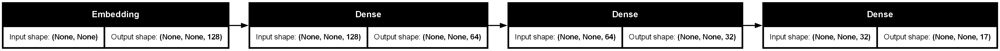

In [63]:

# define the keras model
model = Sequential()

# Input Layer
model.add(Input(shape=(None,)))  # Adjust the shape as needed
model.add(Embedding(len(word2idx), 128))

model.add(Dense(64, activation='leaky_relu'))

# Hidden Layer(s)
model.add(Dense(32, activation='leaky_relu'))

# Output Layer
model.add(Dense(len(tag2idx), activation='softmax'))

model.build()
model.summary()

from tensorflow.keras.utils import plot_model
plot_model(model, to_file='modelFFNN6.png', show_shapes=True, rankdir='LR')

In [65]:

from keras.optimizers import Adam
model.compile(optimizer=Adam(learning_rate=0.001),
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])


### Step 7: Train the Model

In [57]:
from keras._tf_keras.keras.callbacks import ModelCheckpoint, EarlyStopping
from livelossplot.tf_keras import PlotLossesCallback


In [ ]:

logdir="log/"
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)

# chkpt = ModelCheckpoint("model.weights.h5", monitor='val_loss',verbose=1, save_best_only=True, save_weights_only=True, mode='min')

# early_stopping = EarlyStopping(monitor='val_accuracy', min_delta=0, patience=1, verbose=0, mode='max', baseline=None, restore_best_weights=False)

# callbacks = [PlotLossesCallback(), chkpt, early_stopping,tensorboard_callback]
callbacks = [PlotLossesCallback(), tensorboard_callback]

# Convert to numpy arrays and reshape
x_train = np.array(x_train).reshape(-1, 1)
y_train = np.array(y_train).reshape(-1, 1)
x_test = np.array(x_test).reshape(-1, 1)
y_test = np.array(y_test).reshape(-1, 1)

history = model.fit(
    x=x_train,
    y=y_train,
    validation_data=(x_test,y_test),
    batch_size=128,
    epochs=10,
    verbose=1,
    callbacks=callbacks
)

Epoch 1/10


79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 66ms/step - accuracy: 0.7489 - loss: 2.2126 - val_accuracy: 0.8485 - val_loss: 0.6747
Epoch 2/10
79/79 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8580 - loss: 0.5150 - val_accuracy: 0.8677 - val_loss: 0.5680
Epoch 3/10
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 55ms/step - accuracy: 0.8980 - loss: 0.3576 - val_accuracy: 0.8917 - val_loss: 0.4816
Epoch 4/10
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 56ms/step - accuracy: 0.9196 - loss: 0.2766 - val_accuracy: 0.9015 - val_loss: 0.4532
Epoch 5/10
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.9521 - loss: 0.2054 - val_accuracy: 0.9059 - val_loss: 0.4441
Epoch 6/10
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.9623 - loss: 0.1441 - val_accuracy: 0.9104 - val_loss: 0.4446
Epoch 7/10
79/79 ━━━━━━━━━━━━━━━━━━━━ 5s 59ms/step - accuracy: 0.9678 - loss: 0.1271 - val_accuracy: 0.9076 - val_loss: 0.4515
Epoch 8/10
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 56ms/step - accuracy: 0.9674 - loss: 0.1201 - val_accuracy: 0.9081 - val_loss: 0.

### Left Plot (Accuracy)
- **Training Accuracy (red line)**: Increases steadily over epochs, indicating that the model is learning patterns from the training data effectively.
- **Validation Accuracy (blue line)**: Increases initially but starts to plateau and slightly decline after a few epochs. This suggests potential overfitting, where the model starts to perform well on training data but struggles to generalize to unseen validation data.

### Right Plot (Loss)
- **Training Loss (red line)**: Decreases steadily over epochs, which aligns with the increasing training accuracy. It shows the model is minimizing the error on the training data.
- **Validation Loss (blue line)**: Decreases initially but begins to flatten and slightly increase after a few epochs. This further supports the indication of overfitting.

### Key Takeaways
- **Overfitting**: The divergence between training and validation accuracy/loss after a certain point suggests overfitting. The model might be learning noise or details specific to the training data.

### Actionable Steps:
1. Introduce regularization techniques like dropout or weight decay.
2. Use early stopping to halt training when validation performance stops improving.
3. Consider increasing the size of the training dataset or using data augmentation if applicable.

In [25]:
model.predict(x_test)

6554/6554 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step


array([[[2.3073027e-07, 1.9470410e-09, 1.0781569e-05, ...,
         2.7041642e-08, 5.7307051e-07, 7.5681612e-09]],

       [[2.6455873e-05, 2.3281223e-06, 3.1433988e-04, ...,
         3.4060631e-06, 1.0683661e-04, 3.4941456e-06]],

       [[1.0204427e-05, 1.9237893e-06, 1.6408190e-04, ...,
         9.3769989e-07, 7.8547142e-05, 1.3540648e-06]],

       ...,

       [[6.9194211e-04, 1.7064562e-03, 9.3912324e-03, ...,
         3.0634578e-04, 2.7624129e-03, 1.3830623e-04]],

       [[3.9760656e-07, 8.6120693e-09, 4.9750597e-06, ...,
         2.4210154e-08, 2.4199619e-07, 6.8763111e-09]],

       [[4.3429122e-03, 4.2799045e-03, 3.3744555e-03, ...,
         7.0399122e-04, 4.1853901e-04, 1.8499036e-04]]], dtype=float32)

In [35]:
%load_ext tensorboard

%tensorboard --logdir log --reload_multifile=True

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


ERROR: Failed to launch TensorBoard (exited with 1).
Contents of stderr:
2025-02-09 21:57:26.516993: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-02-09 21:57:28.582433: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
Traceback (most recent call last):
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "c:\Users\nickl\Documents\MI\.venv\Scripts\tensorboard.exe\__main__.py", line 7, in <module>
  File "c:\Users\nickl\Documents\MI\.venv\Lib\site-packages\tensorboard\main.py", line 41, in run_m

#### Apply TensorBoard to check the detailed structure and performance

### Step 8: Evaluate the performance of Named Entity Recognition Model

In [30]:
i = np.random.randint(0, len(x_test) - 50)
print("This is sentence:", i)
p = model.predict(x_test[i:i+50].reshape(1, -1))
p = np.argmax(p, axis=-1)
print(i, p)

print("{:15}{:5}\t {}\n".format("Word", "True", "Pred"))
print("-" * 30)
for w, true, pred in zip(x_test[i:i+50], y_test[i:i+50], p[0]):
    print("{:15}{}\t{}".format(words[w[0] - 1], tags[true[0]], tags[pred]))


This is sentence: 199340
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
199340 [[14 14 14 14 14 14 14 14 14 14 14 14 14  4 14 14 14 14 14 14 14 14 14 14
  14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
  14 14]]
Word           True 	 Pred

------------------------------
along          O	O
with           O	O
the            O	O
neighboring    O	O
island         O	O
of             O	O
Bonaire        B-geo	O
.              O	O
Once           O	O
the            O	O
center         O	O
of             O	O
the            O	O
Caribbean      B-geo	B-geo
slave          O	O
trade          O	O
,              O	O
Curacao        B-org	O
was            O	O
hard           O	O
hit            O	O
by             O	O
the            O	O
abolition      O	O
of             O	O
slavery        O	O
in             O	O
1863           B-tim	O
.              O	O
Its            O	O
prosperity     O	O
(              O	O
and            O	O
that           O	O
of             O	O
neighboring    O	O
Aruba    

In [31]:
from sklearn.metrics import f1_score

print("Evaluate on test data")
results = model.evaluate(x_test, y_test, batch_size=128)
print("test loss: {} ".format(results[0]))
print("test accuracy: {} ".format(results[1]))


# Get predictions for the entire test set
out = model.predict(x_test)
preds = np.argmax(out, axis=-1)  # Change axis to -1

# Print shapes for debugging
print("y_test shape:", y_test.shape)
print("predictions shape:", preds.shape)

# Ensure consistent shapes
y_test_flat = y_test.reshape(-1)  # Flatten to 1D array
preds_flat = preds.reshape(-1)    # Flatten predictions to same shape

# Calculate and print F1 score
print("F1 score: ", f1_score(y_test_flat, preds_flat, average='macro'))


Evaluate on test data
1639/1639 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.9054 - loss: 0.4762
test loss: 0.4816451072692871 
test accuracy: 0.9047039747238159 
6554/6554 ━━━━━━━━━━━━━━━━━━━━ 6s 948us/step
y_test shape: (209715, 1)
predictions shape: (209715, 1)
F1 score:  0.2947919469598115
